In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import os
# set your Google Drive folder path
DRIVE_FOLDER = '/content/drive/My Drive/'
# List all files and folders in the directory
for filename in os.listdir(DRIVE_FOLDER):
    print(filename)

Colab Notebooks
CIFAR-10
Part1-Build Deep_Architecture .gdoc
Computer_Vision
monet_jpg
photo_jpg
gandido_generator.h5
input_photo_0.png
gandido_transformation_0.png
input_photo_1.png
gandido_transformation_1.png
input_photo_2.png
gandido_transformation_2.png
input_photo_3.png
gandido_transformation_3.png
input_photo_4.png
gandido_transformation_4.png
input_photo_5.png
gandido_transformation_5.png
input_photo_6.png
gandido_transformation_6.png
input_photo_7.png
gandido_transformation_7.png
input_photo_8.png
gandido_transformation_8.png
input_photo_9.png
gandido_transformation_9.png
zurich.jpeg
clear_images
louvre.jpg
starry_night.jpg
image_0.jpg
your_folder
856047.jpg


In [ ]:
BASE_PATH = '/content/drive/My Drive/'
MONET_PATH = os.path.join(BASE_PATH, 'monet_jpg')
PHOTO_PATH = os.path.join(BASE_PATH, 'photo_jpg')

In [ ]:
#!pip install tensorflow-addons


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 612.1/612.1 kB 12.1 MB/s eta 0:00:00


In [ ]:
import os
import pathlib
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
import tensorflow_addons as tfa

orig_img_size = (256, 256)
input_img_size = (256, 256, 3)
kernel_init = keras.initializers.RandomNormal(mean=0.0, stddev=0.02)
gamma_init = keras.initializers.RandomNormal(mean=0.0, stddev=0.02)

class ReflectionPadding2D(layers.Layer):
    def __init__(self, padding=(1, 1), **kwargs):
        self.padding = tuple(padding)
        super(ReflectionPadding2D, self).__init__(**kwargs)

    def call(self, input_tensor, mask=None):
        padding_width, padding_height = self.padding
        padding_tensor = [
            [0, 0],
            [padding_height, padding_height],
            [padding_width, padding_width],
            [0, 0],
        ]
        return tf.pad(input_tensor, padding_tensor, mode="REFLECT")

def residual_block(
    x,
    activation,
    kernel_initializer = kernel_init,
    kernel_size = (3, 3),
    strides = (1, 1),
    padding = "valid",
    gamma_initializer = gamma_init,
    use_bias = False,
):
    dim = x.shape[-1]
    input_tensor = x

    x = ReflectionPadding2D()(input_tensor)
    x = layers.Conv2D(
        dim,
        kernel_size,
        strides = strides,
        kernel_initializer = kernel_initializer,
        padding = padding,
        use_bias = use_bias,
    )(x)
    x = tfa.layers.InstanceNormalization(gamma_initializer = gamma_initializer)(x)
    x = activation(x)

    x = ReflectionPadding2D()(x)
    x = layers.Conv2D(
        dim,
        kernel_size,
        strides = strides,
        kernel_initializer = kernel_initializer,
        padding = padding,
        use_bias = use_bias,
    )(x)
    x = tfa.layers.InstanceNormalization(gamma_initializer = gamma_initializer)(x)
    x = layers.add([input_tensor, x])
    return x

def downsample(
    x,
    filters,
    activation,
    kernel_initializer = kernel_init,
    kernel_size = (3, 3),
    strides = (2, 2),
    padding = "same",
    gamma_initializer = gamma_init,
    use_bias = False
):
    x = layers.Conv2D(
        filters,
        kernel_size,
        strides = strides,
        kernel_initializer = kernel_initializer,
        padding = padding,
        use_bias = use_bias,
    )(x)
    x = tfa.layers.InstanceNormalization(gamma_initializer = gamma_initializer)(x)
    if activation:
        x = activation(x)

    return x

def upsample(
    x,
    filters,
    activation,
    kernel_initializer = kernel_init,
    kernel_size = (3, 3),
    strides = (2, 2),
    padding = "same",
    gamma_initializer = gamma_init,
    use_bias = False
):
    x = layers.Conv2DTranspose(
        filters,
        kernel_size,
        strides = strides,
        padding = padding,
        kernel_initializer = kernel_initializer,
        use_bias = use_bias,
    )(x)
    x = tfa.layers.InstanceNormalization(gamma_initializer = gamma_initializer)(x)
    if activation:
        x = activation(x)

    return x

def get_resnet_generator(
    filters = 64,
    num_downsampling_blocks = 2,
    num_residual_blocks = 9,
    num_upsampling_blocks = 2,
    gamma_initializer = gamma_init,
    name = None,
):
    img_input = layers.Input(shape = input_img_size, name = name+"_img_input")
    x = ReflectionPadding2D(padding=(3, 3))(img_input)
    x = layers.Conv2D(filters, (7, 7), kernel_initializer=kernel_init, use_bias=False)(x)
    x = tfa.layers.InstanceNormalization(gamma_initializer=gamma_initializer)(x)
    x = layers.Activation('relu')(x)

    for _ in range(num_downsampling_blocks):
        filters *= 2
        x = downsample(x, filters=filters, activation=layers.Activation('relu'))

    for _ in range(num_residual_blocks):
        x = residual_block(x, activation=layers.Activation('relu'))

    for _ in range(num_upsampling_blocks):
        filters //= 2
        x = upsample(x, filters=filters, activation=layers.Activation('relu'))

    x = ReflectionPadding2D(padding=(3, 3))(x)
    x = layers.Conv2D(3, (7, 7), padding="valid")(x)
    x = layers.Activation('tanh')(x)

    model = keras.models.Model(img_input, x, name=name)
    return model

def get_discriminator(
    filters=64, kernel_initializer=kernel_init, num_downsampling=3, name=None
):
    img_input = layers.Input(shape=input_img_size, name=name+"_img_input")
    x = layers.Conv2D(
        filters,
        (4, 4),
        strides = (2, 2),
        padding = "same",
        kernel_initializer = kernel_initializer,
    )(img_input)
    x = layers.LeakyReLU(0.2)(x)

    num_filters = filters
    for num_downsample_block in range(3):
        num_filters *= 2
        if num_downsample_block < 2:
            x = downsample(
                x,
                filters=num_filters,
                activation=layers.LeakyReLU(0.2),
                kernel_size=(4, 4),
                strides=(2, 2),
            )
        else:
            x = downsample(
                x,
                filters=num_filters,
                activation=layers.LeakyReLU(0.2),
                kernel_size=(4, 4),
                strides=(1, 1),
            )

    x = layers.Conv2D(
        1, (4, 4), strides=(1, 1), padding="same", kernel_initializer=kernel_initializer
    )(x)

    model = keras.models.Model(inputs=img_input, outputs=x, name=name)
    return model

/usr/local/lib/python3.10/dist-packages/tensorflow_addons/utils/tfa_eol_msg.py:23: UserWarning: 

TensorFlow Addons (TFA) has ended development and introduction of new features.
TFA has entered a minimal maintenance and release mode until a planned end of life in May 2024.
Please modify downstream libraries to take dependencies from other repositories in our TensorFlow community (e.g. Keras, Keras-CV, and Keras-NLP). 

For more information see: https://github.com/tensorflow/addons/issues/2807 

  warnings.warn(


300/300 [==============================] - ETA: 0s - G_loss: 5.0670 - F_loss: 5.5977 - D_X_loss: 0.1036 - D_Y_loss: 0.1239

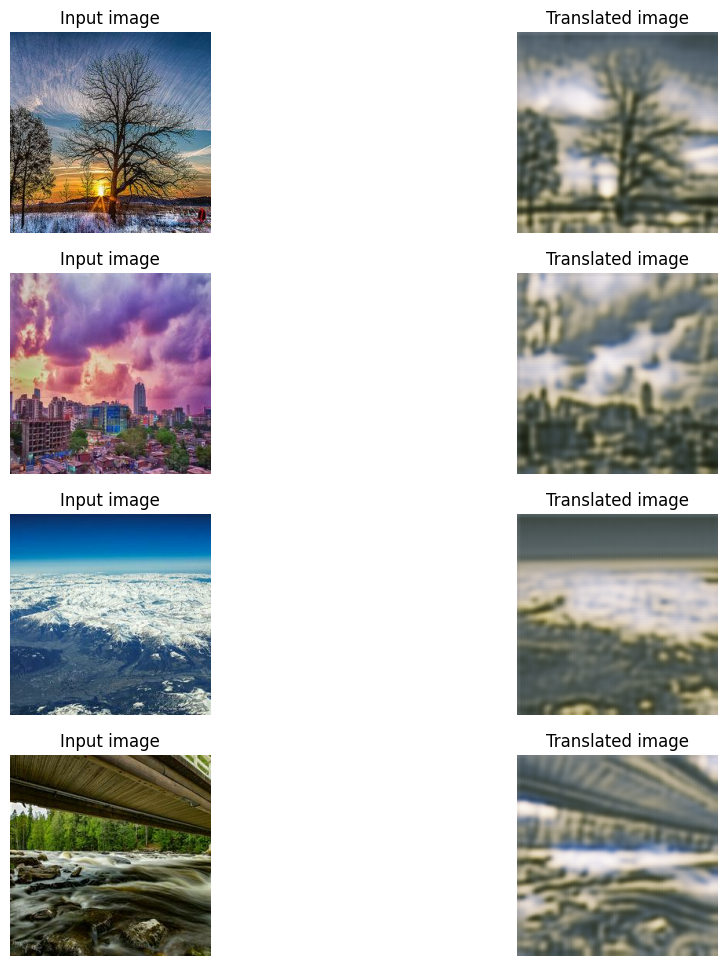

300/300 [==============================] - 135s 219ms/step - G_loss: 5.0652 - F_loss: 5.5968 - D_X_loss: 0.1035 - D_Y_loss: 0.1241


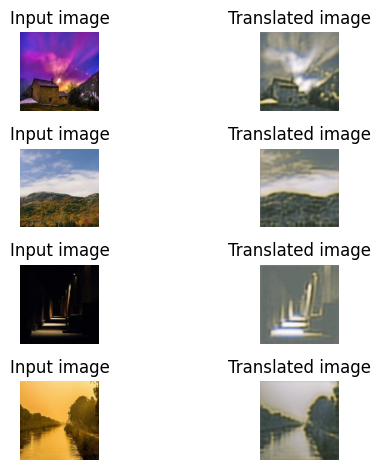

In [ ]:
# Import the required libraries

import os
import pathlib
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
import tensorflow_addons as tfa


from tensorflow.keras.initializers import RandomNormal

# Create the initializer with a seed
initializer = RandomNormal(mean=0.0, stddev=0.05, seed=42)

# Use the initializer in a layer
layer = keras.layers.Dense(128, kernel_initializer=initializer)


autotune = tf.data.experimental.AUTOTUNE

# Define the path of the directories
photo_directory = '/content/drive/My Drive/photo_jpg/'
monet_directory = '/content/drive/My Drive/monet_jpg/'
ds_photo = tf.data.Dataset.list_files(str(pathlib.Path(photo_directory+'*.jpg')))
ds_monet = tf.data.Dataset.list_files(str(pathlib.Path(monet_directory+'*.jpg')))

# Define a function to parse through the images
def process_path(file_path):
    image = tf.io.read_file(file_path)
    image = tf.image.decode_jpeg(image, channels = 3)
    return image

ds_photo = ds_photo.map(process_path)
ds_photo = ds_photo.prefetch(256)
ds_monet = ds_monet.map(process_path)
ds_monet = ds_monet.prefetch(256)

# Define the initializers to set the initial random weights
orig_img_size = (256, 256)
input_img_size = (256, 256, 3)
kernel_init = keras.initializers.RandomNormal(mean=0.0, stddev=0.02)
gamma_init = keras.initializers.RandomNormal(mean=0.0, stddev=0.02)

buffer_size = 256
batch_size = 1

# Normalize the images
def normalize_img(img):
    img = tf.cast(img, dtype=tf.float32)
    return ((img/127.5) - 1.0)

# Preprocess the images
def preprocess_train_image(img):
    img = tf.image.random_flip_left_right(img)
    img = tf.image.resize(img, [*orig_img_size])
    img = tf.image.random_crop(img, size=[*input_img_size])
    img = normalize_img(img)
    return img

# Map the preprocess function to already existing dataset object
ds_photo = (
    ds_photo.map(preprocess_train_image, num_parallel_calls=autotune)
    .cache()
    .shuffle(buffer_size)
    .batch(batch_size)
)

ds_monet = (
    ds_monet.map(preprocess_train_image, num_parallel_calls=autotune)
    .cache()
    .shuffle(buffer_size)
    .batch(batch_size)
)

# Define the generators
gen_G = get_resnet_generator(name="generator_G")
gen_F = get_resnet_generator(name="generator_F")

# Define the discriminators
disc_X = get_discriminator(name="discriminator_X")
disc_Y = get_discriminator(name="discriminator_Y")

# CycleGAN model
class CycleGan(keras.Model):
    def __init__(
        self,
        generator_G,
        generator_F,
        discriminator_X,
        discriminator_Y,
        lambda_cycle=10.0,
        lambda_identity=0.5
    ):
        super(CycleGan, self).__init__()
        self.gen_G = generator_G
        self.gen_F = generator_F
        self.disc_X = discriminator_X
        self.disc_Y = discriminator_Y
        self.lambda_cycle = lambda_cycle
        self.lambda_identity = lambda_identity

    def compile(
        self,
        gen_G_optimizer,
        gen_F_optimizer,
        disc_X_optimizer,
        disc_Y_optimizer,
        gen_loss_fn,
        disc_loss_fn,
    ):
        super(CycleGan, self).compile()
        self.gen_G_optimizer = gen_G_optimizer
        self.gen_F_optimizer = gen_F_optimizer
        self.disc_X_optimizer = disc_X_optimizer
        self.disc_Y_optimizer = disc_Y_optimizer
        self.generator_loss_fn = gen_loss_fn
        self.discriminator_loss_fn = disc_loss_fn
        self.cycle_loss_fn = keras.losses.MeanAbsoluteError()
        self.identity_loss_fn = keras.losses.MeanAbsoluteError()

    def train_step(self, batch_data):
        # x is photo and y is monet
        real_x, real_y = batch_data

        with tf.GradientTape(persistent=True) as tape:
            # Photo to fake monet
            fake_y = self.gen_G(real_x, training=True)
            # Monet to fake photo -> y2x
            fake_x = self.gen_F(real_y, training=True)

            # Cycle (Photo to fake monet to fake photo): x -> y -> x
            cycled_x = self.gen_F(fake_y, training=True)
            # Cycle (Monet to fake photo to fake monet) y -> x -> y
            cycled_y = self.gen_G(fake_x, training=True)

            # Identity mapping
            same_x = self.gen_F(real_x, training=True)
            same_y = self.gen_G(real_y, training=True)

            # Discriminator output
            disc_real_x = self.disc_X(real_x, training=True)
            disc_fake_x = self.disc_X(fake_x, training=True)

            disc_real_y = self.disc_Y(real_y, training=True)
            disc_fake_y = self.disc_Y(fake_y, training=True)

            # Generator adverserial loss
            gen_G_loss = self.generator_loss_fn(disc_fake_y)
            gen_F_loss = self.generator_loss_fn(disc_fake_x)

            # Generator cycle loss
            cycle_loss_G = self.cycle_loss_fn(real_y, cycled_y) * self.lambda_cycle
            cycle_loss_F = self.cycle_loss_fn(real_x, cycled_x) * self.lambda_cycle

            id_loss_G = (
                self.identity_loss_fn(real_y, same_y)
                * self.lambda_cycle
                * self.lambda_identity
            )
            id_loss_F = (
                self.identity_loss_fn(real_x, same_x)
                * self.lambda_cycle
                * self.lambda_identity
            )

            # Total generator loss
            total_loss_G = gen_G_loss + cycle_loss_G + id_loss_G
            total_loss_F = gen_F_loss + cycle_loss_F + id_loss_F

            # Discriminator loss
            disc_X_loss = self.discriminator_loss_fn(disc_real_x, disc_fake_x)
            disc_Y_loss = self.discriminator_loss_fn(disc_real_y, disc_fake_y)

        # Get the gradients for the generators
        grads_G = tape.gradient(total_loss_G, self.gen_G.trainable_variables)
        grads_F = tape.gradient(total_loss_F, self.gen_F.trainable_variables)

        # Get the gradients for the discriminators
        disc_X_grads = tape.gradient(disc_X_loss, self.disc_X.trainable_variables)
        disc_Y_grads = tape.gradient(disc_Y_loss, self.disc_Y.trainable_variables)

        # Update the weights of the generators
        self.gen_G_optimizer.apply_gradients(
            zip(grads_G, self.gen_G.trainable_variables)
        )
        self.gen_F_optimizer.apply_gradients(
            zip(grads_F, self.gen_F.trainable_variables)
        )

        # Update the weights of the discriminators
        self.disc_X_optimizer.apply_gradients(
            zip(disc_X_grads, self.disc_X.trainable_variables)
        )
        self.disc_Y_optimizer.apply_gradients(
            zip(disc_Y_grads, self.disc_Y.trainable_variables)
        )

        return {
            "G_loss": total_loss_G,
            "F_loss": total_loss_F,
            "D_X_loss": disc_X_loss,
            "D_Y_loss": disc_Y_loss,
        }

# A callback function to view the results after each epoch
class GANMonitor(keras.callbacks.Callback):
    def __init__(self, num_img=4):
        self.num_img = num_img

    def on_epoch_end(self, epoch, logs=None):
        _, ax = plt.subplots(4, 2, figsize=(12, 12))
        for i, img in enumerate(ds_photo.take(self.num_img)):
            prediction = self.model.gen_G(img)[0].numpy()
            prediction = (prediction * 127.5 + 127.5).astype(np.uint8)
            img = (img[0] * 127.5 + 127.5).numpy().astype(np.uint8)

            ax[i, 0].imshow(img)
            ax[i, 1].imshow(prediction)
            ax[i, 0].set_title("Input image")
            ax[i, 1].set_title("Translated image")
            ax[i, 0].axis("off")
            ax[i, 1].axis("off")

        plt.show()
        plt.close()

# Loss function for evaluating adversarial loss
adv_loss_fn = keras.losses.MeanSquaredError()

# Define the loss function for the generators
def generator_loss_fn(fake):
    fake_loss = adv_loss_fn(tf.ones_like(fake), fake)
    return fake_loss


# Define the loss function for the discriminators
def discriminator_loss_fn(real, fake):
    real_loss = adv_loss_fn(tf.ones_like(real), real)
    fake_loss = adv_loss_fn(tf.zeros_like(fake), fake)
    return (real_loss + fake_loss) * 0.5

# Create cycleGAN model
cycle_gan_model = CycleGan(
    generator_G=gen_G, generator_F=gen_F, discriminator_X=disc_X, discriminator_Y=disc_Y
)

# Compile the model
cycle_gan_model.compile(
    gen_G_optimizer=keras.optimizers.Adam(learning_rate=2e-4, beta_1=0.5),
    gen_F_optimizer=keras.optimizers.Adam(learning_rate=2e-4, beta_1=0.5),
    disc_X_optimizer=keras.optimizers.Adam(learning_rate=2e-4, beta_1=0.5),
    disc_Y_optimizer=keras.optimizers.Adam(learning_rate=2e-4, beta_1=0.5),
    gen_loss_fn=generator_loss_fn,
    disc_loss_fn=discriminator_loss_fn,
)

plotter = GANMonitor()  # Define the plotter for plotting results after each epoch

# Fit the model
cycle_gan_model.fit(
    tf.data.Dataset.zip((ds_photo, ds_monet)),
    epochs=1,
    callbacks=[plotter], #, model_checkpoint_callback],
)

# Save the final weights
#model_filepath = "

# Create the initializer with a seed
initializer = RandomNormal(mean=0.0, stddev=0.05, seed=42)


fig, ax = plt.subplots(nrows=4, ncols=2)  # Define the axes

for i, img in enumerate(ds_photo.take(4)):
    prediction = cycle_gan_model.gen_G(img, training=False)[0].numpy()
    prediction = (prediction * 127.5 + 127.5).astype(np.uint8)
    img = (img[0] * 127.5 + 127.5).numpy().astype(np.uint8)

    ax[i, 0].imshow(img)
    ax[i, 1].imshow(prediction)
    ax[i, 0].set_title("Input image")
    ax[i, 0].set_title("Input image")
    ax[i, 1].set_title("Translated image")
    ax[i, 0].axis("off")
    ax[i, 1].axis("off")

    prediction = keras.preprocessing.image.array_to_img(prediction)
    prediction.save("predicted_img_{i}.png".format(i=i))
plt.tight_layout()
plt.show()

Epoch 1/25
300/300 [==============================] - ETA: 0s - G_loss: 4.7410 - F_loss: 5.1034 - D_X_loss: 0.3710 - D_Y_loss: 0.3171

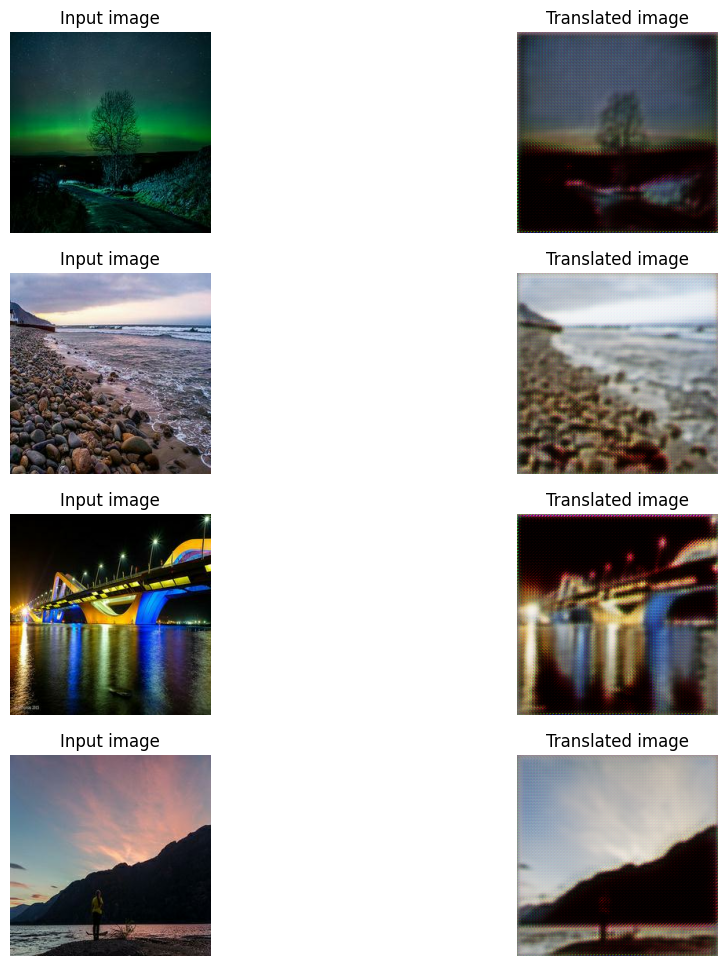

300/300 [==============================] - 66s 142ms/step - G_loss: 4.7359 - F_loss: 5.0983 - D_X_loss: 0.3708 - D_Y_loss: 0.3170
Epoch 2/25
300/300 [==============================] - ETA: 0s - G_loss: 4.2053 - F_loss: 4.4330 - D_X_loss: 0.2684 - D_Y_loss: 0.2562

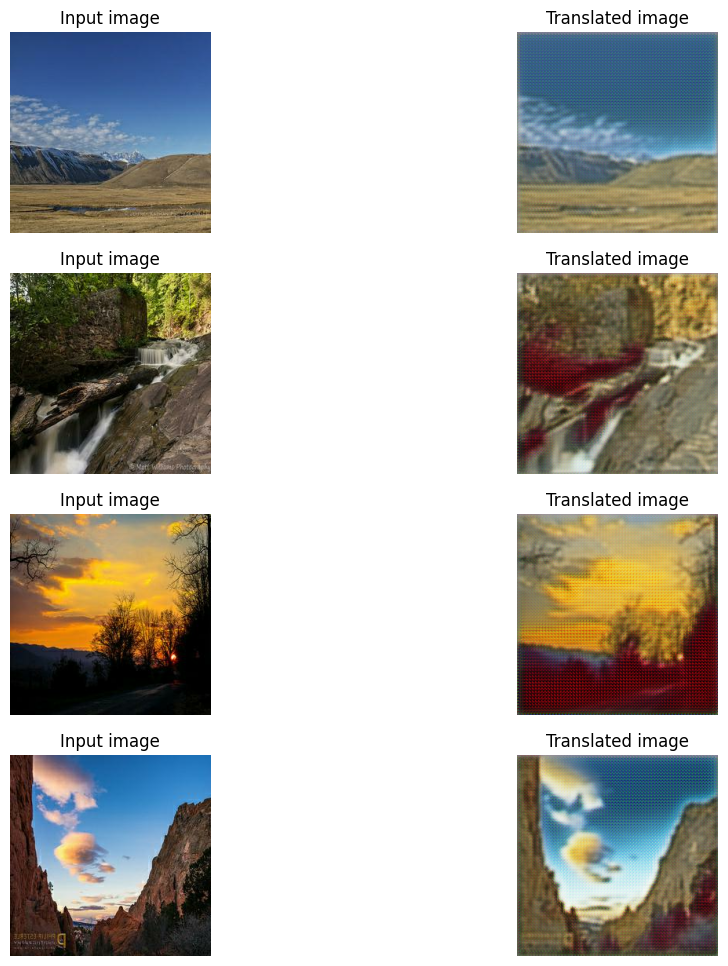

300/300 [==============================] - 43s 143ms/step - G_loss: 4.2027 - F_loss: 4.4340 - D_X_loss: 0.2684 - D_Y_loss: 0.2564
Epoch 3/25
300/300 [==============================] - ETA: 0s - G_loss: 3.9912 - F_loss: 4.1409 - D_X_loss: 0.2583 - D_Y_loss: 0.2494

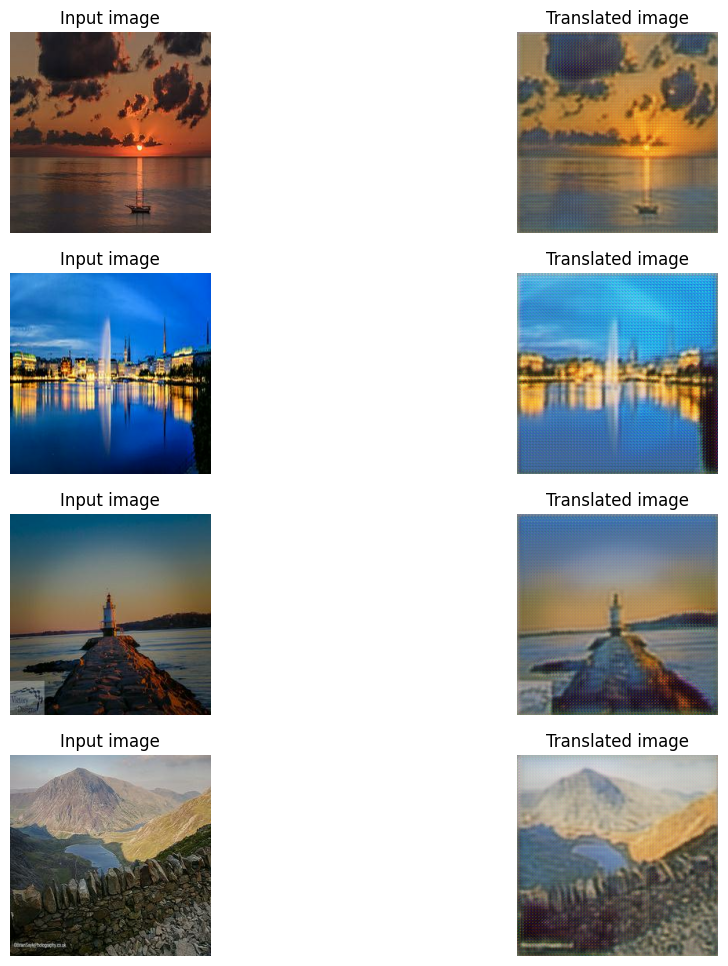

300/300 [==============================] - 43s 143ms/step - G_loss: 3.9910 - F_loss: 4.1451 - D_X_loss: 0.2581 - D_Y_loss: 0.2495
Epoch 4/25
300/300 [==============================] - ETA: 0s - G_loss: 3.7410 - F_loss: 3.9134 - D_X_loss: 0.2515 - D_Y_loss: 0.2463

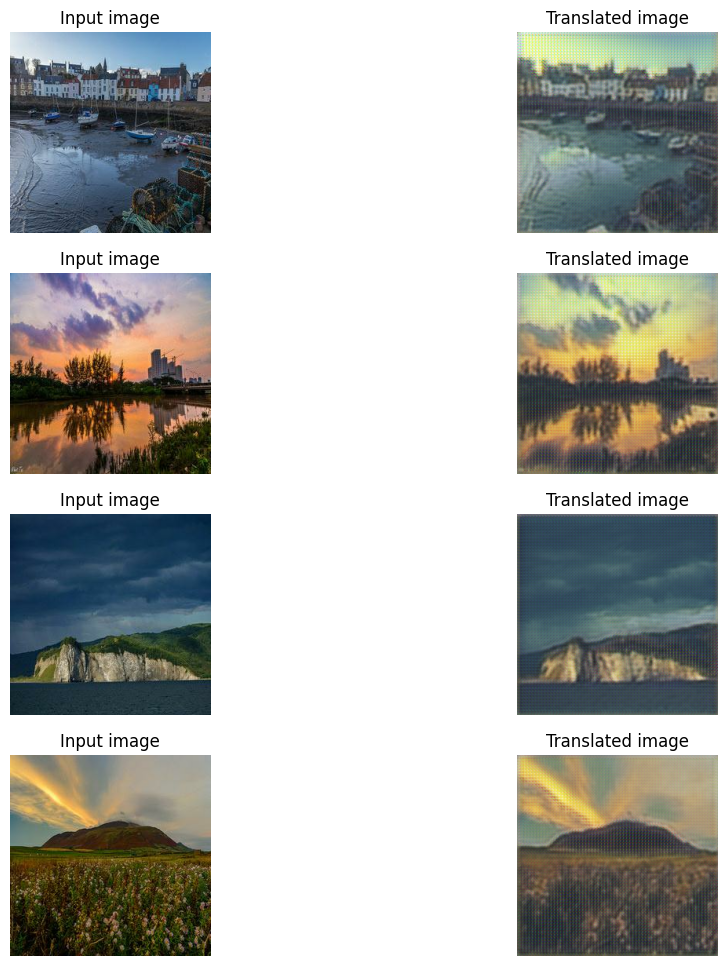

300/300 [==============================] - 43s 144ms/step - G_loss: 3.7403 - F_loss: 3.9108 - D_X_loss: 0.2514 - D_Y_loss: 0.2463
Epoch 5/25
300/300 [==============================] - ETA: 0s - G_loss: 3.5729 - F_loss: 3.8634 - D_X_loss: 0.2466 - D_Y_loss: 0.2405

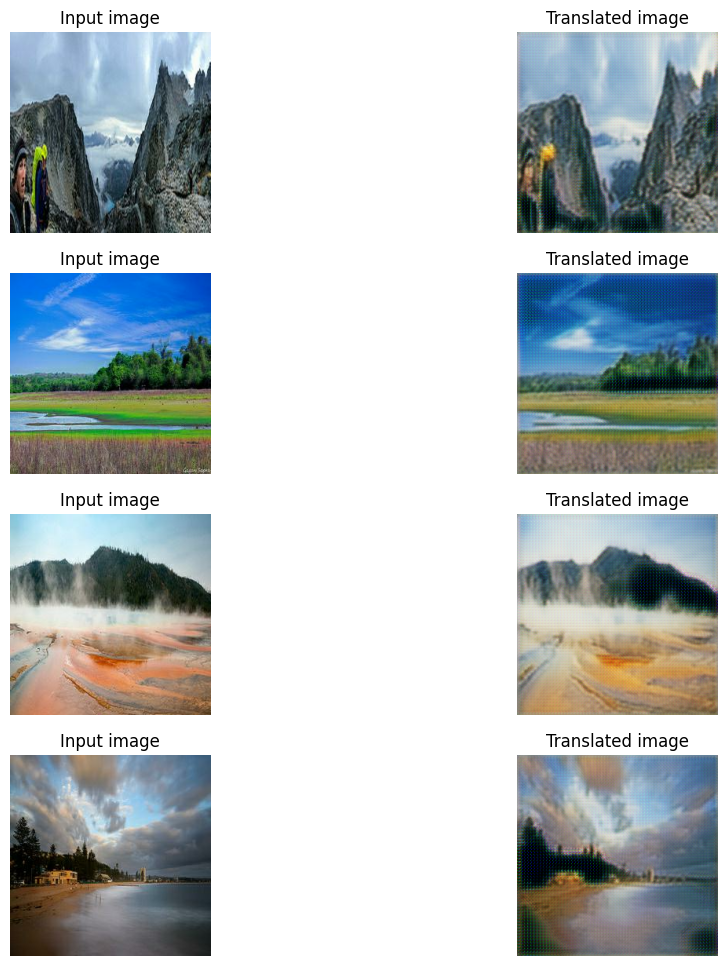

300/300 [==============================] - 43s 143ms/step - G_loss: 3.5737 - F_loss: 3.8620 - D_X_loss: 0.2467 - D_Y_loss: 0.2404
Epoch 6/25
300/300 [==============================] - ETA: 0s - G_loss: 3.4862 - F_loss: 3.6772 - D_X_loss: 0.2456 - D_Y_loss: 0.2417

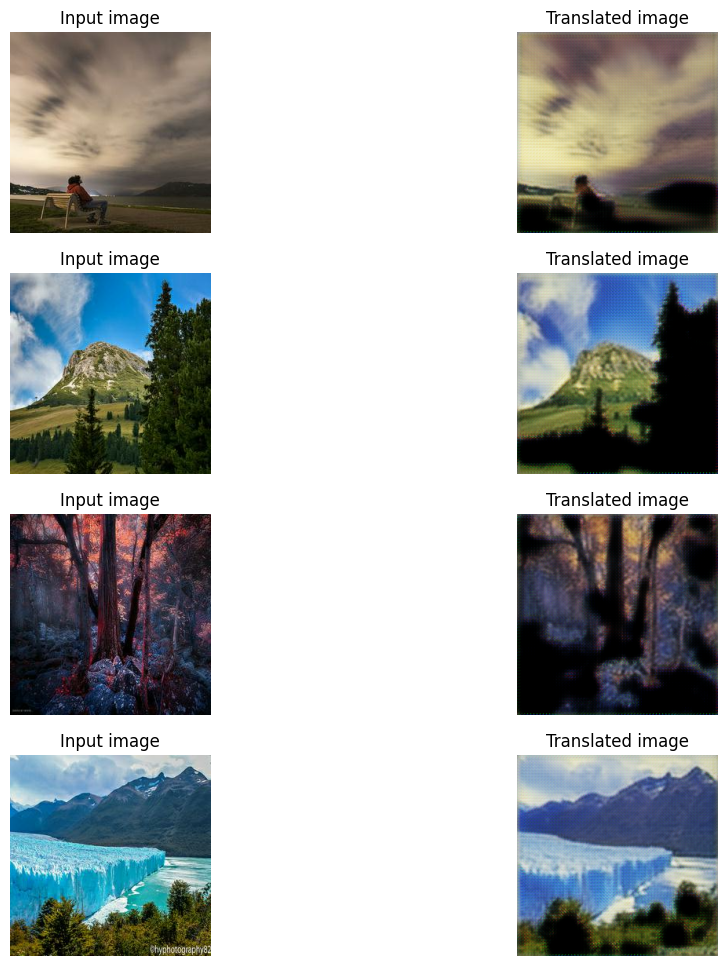

300/300 [==============================] - 43s 143ms/step - G_loss: 3.4826 - F_loss: 3.6732 - D_X_loss: 0.2458 - D_Y_loss: 0.2419
Epoch 7/25
300/300 [==============================] - ETA: 0s - G_loss: 3.3412 - F_loss: 3.4306 - D_X_loss: 0.2446 - D_Y_loss: 0.2397

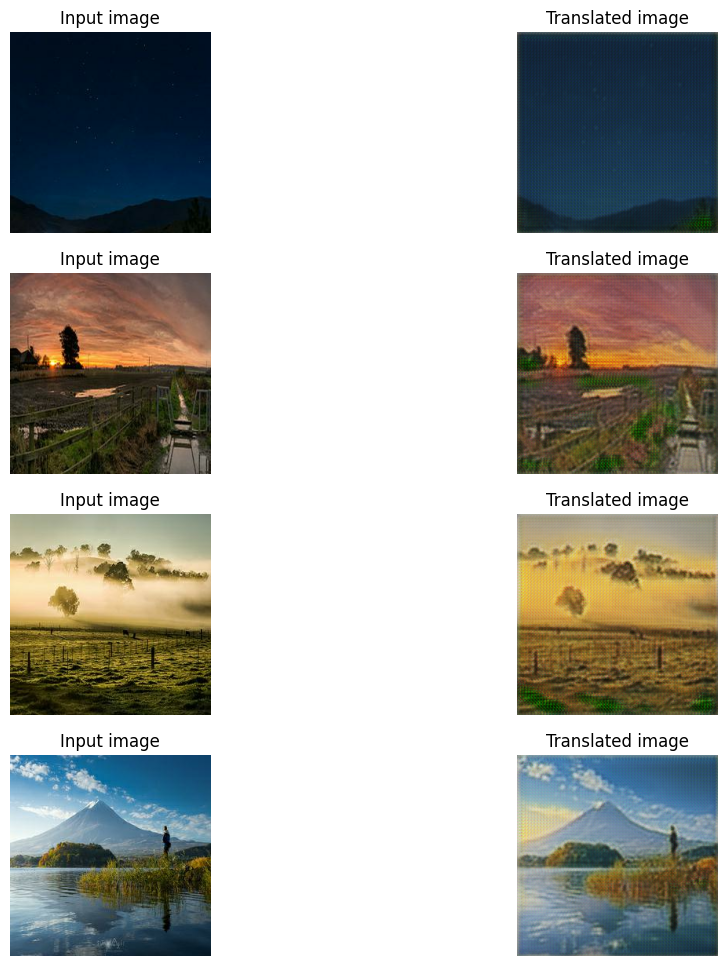

300/300 [==============================] - 43s 143ms/step - G_loss: 3.3415 - F_loss: 3.4337 - D_X_loss: 0.2445 - D_Y_loss: 0.2397
Epoch 8/25
300/300 [==============================] - ETA: 0s - G_loss: 3.3660 - F_loss: 3.5442 - D_X_loss: 0.2412 - D_Y_loss: 0.2378

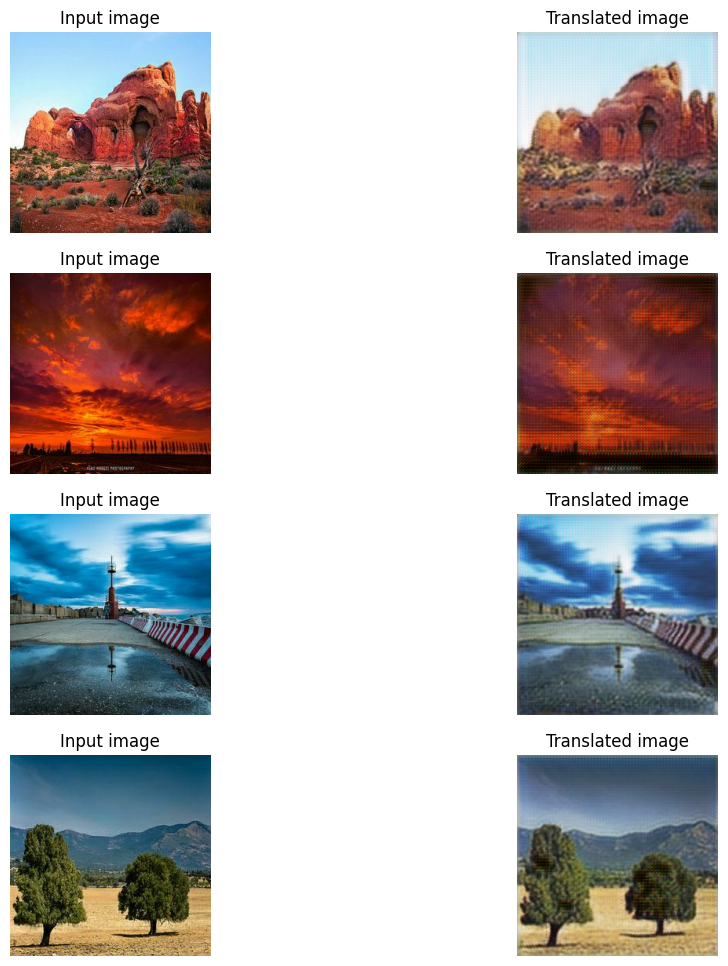

300/300 [==============================] - 43s 143ms/step - G_loss: 3.3628 - F_loss: 3.5454 - D_X_loss: 0.2414 - D_Y_loss: 0.2377
Epoch 9/25
300/300 [==============================] - ETA: 0s - G_loss: 3.2540 - F_loss: 3.5424 - D_X_loss: 0.2378 - D_Y_loss: 0.2385

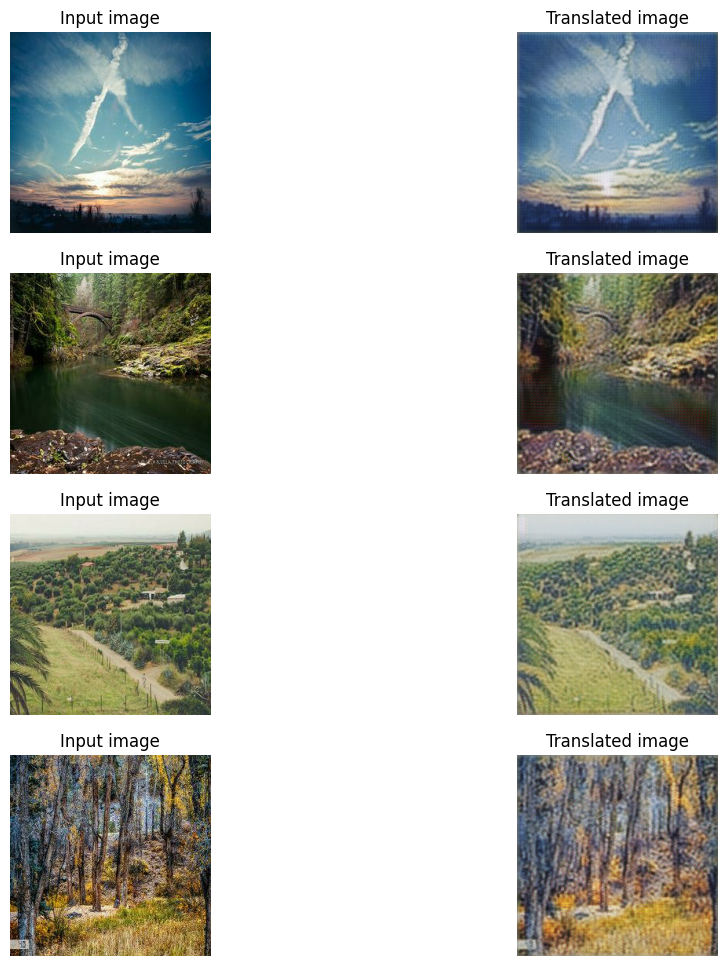

300/300 [==============================] - 43s 143ms/step - G_loss: 3.2525 - F_loss: 3.5432 - D_X_loss: 0.2378 - D_Y_loss: 0.2386
Epoch 10/25
300/300 [==============================] - ETA: 0s - G_loss: 3.1531 - F_loss: 3.3247 - D_X_loss: 0.2406 - D_Y_loss: 0.2377

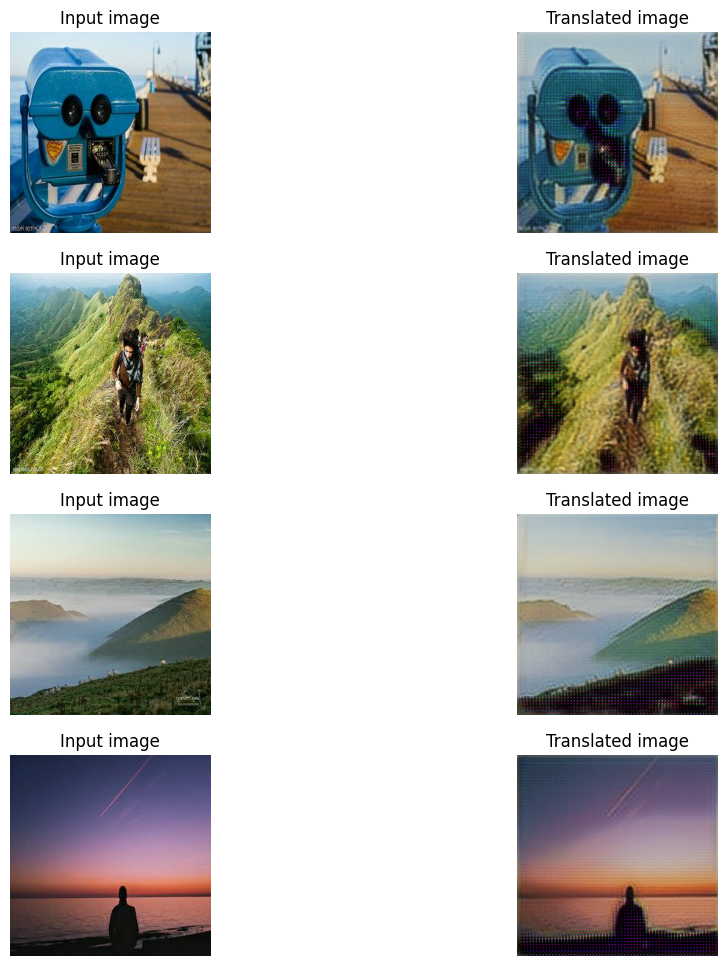

300/300 [==============================] - 43s 143ms/step - G_loss: 3.1549 - F_loss: 3.3263 - D_X_loss: 0.2408 - D_Y_loss: 0.2375
Epoch 11/25
300/300 [==============================] - ETA: 0s - G_loss: 3.1779 - F_loss: 3.4017 - D_X_loss: 0.2398 - D_Y_loss: 0.2363

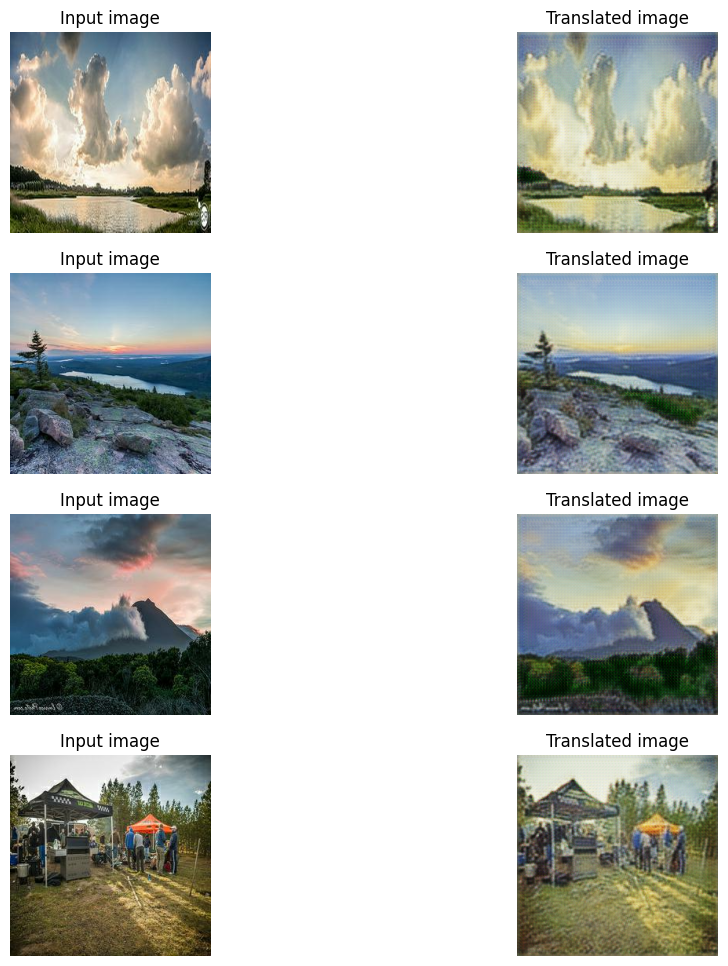

300/300 [==============================] - 43s 143ms/step - G_loss: 3.1772 - F_loss: 3.4069 - D_X_loss: 0.2405 - D_Y_loss: 0.2363
Epoch 12/25
300/300 [==============================] - ETA: 0s - G_loss: 3.1203 - F_loss: 3.3520 - D_X_loss: 0.2380 - D_Y_loss: 0.2380

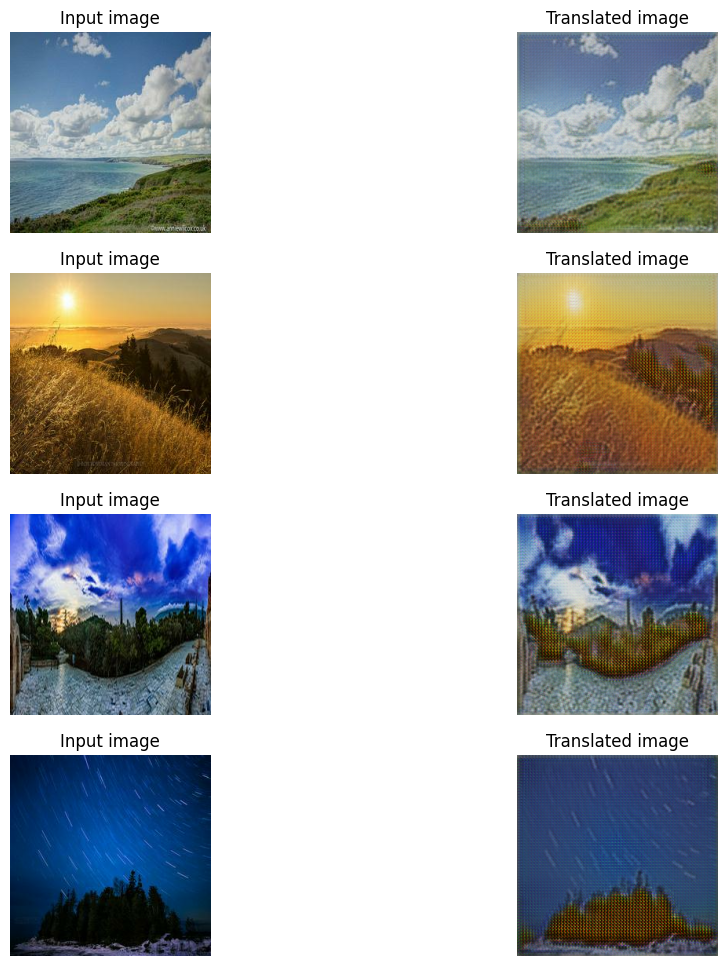

300/300 [==============================] - 43s 143ms/step - G_loss: 3.1185 - F_loss: 3.3553 - D_X_loss: 0.2377 - D_Y_loss: 0.2378
Epoch 13/25
300/300 [==============================] - ETA: 0s - G_loss: 3.0369 - F_loss: 3.2256 - D_X_loss: 0.2342 - D_Y_loss: 0.2348

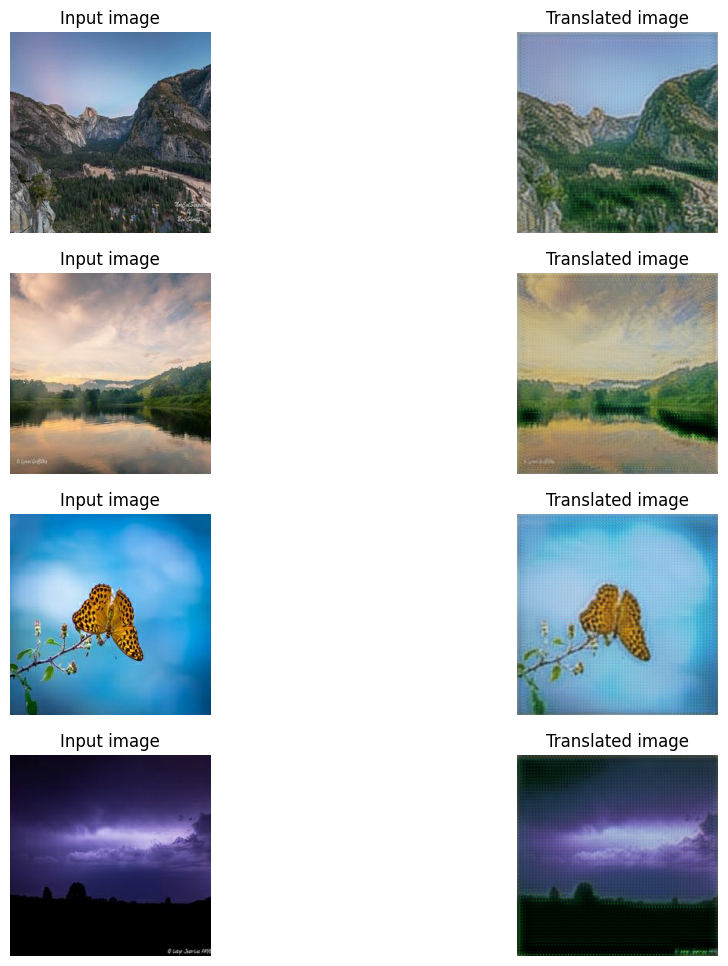

300/300 [==============================] - 43s 143ms/step - G_loss: 3.0361 - F_loss: 3.2252 - D_X_loss: 0.2341 - D_Y_loss: 0.2350
Epoch 14/25
300/300 [==============================] - ETA: 0s - G_loss: 2.9927 - F_loss: 3.1566 - D_X_loss: 0.2349 - D_Y_loss: 0.2344

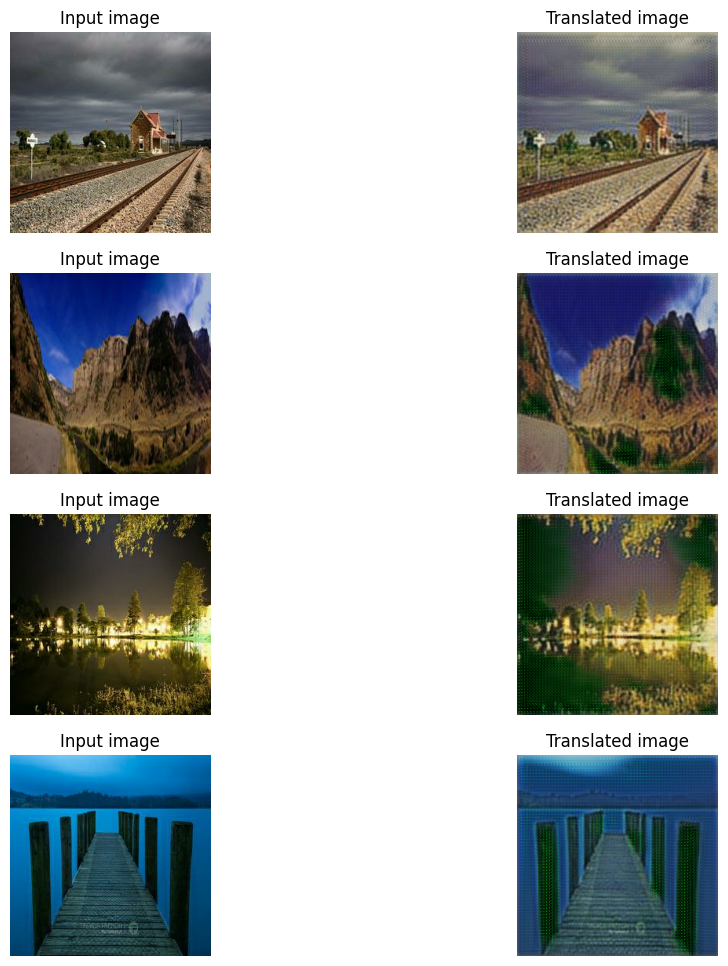

300/300 [==============================] - 43s 143ms/step - G_loss: 2.9918 - F_loss: 3.1544 - D_X_loss: 0.2350 - D_Y_loss: 0.2344
Epoch 15/25
300/300 [==============================] - ETA: 0s - G_loss: 3.0288 - F_loss: 3.1655 - D_X_loss: 0.2328 - D_Y_loss: 0.2368

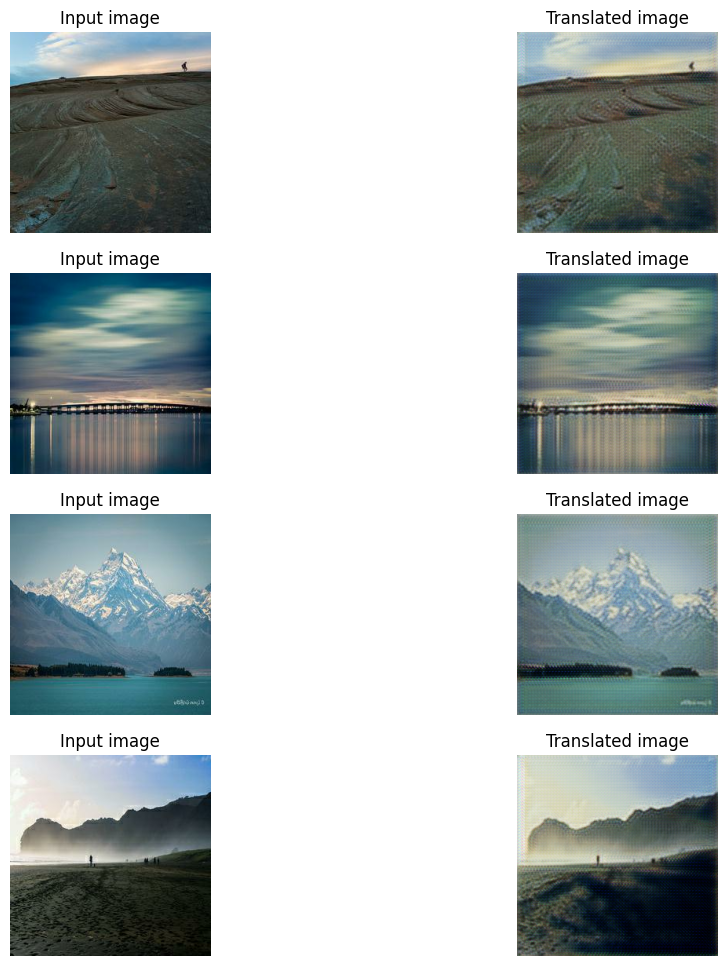

300/300 [==============================] - 44s 145ms/step - G_loss: 3.0270 - F_loss: 3.1674 - D_X_loss: 0.2328 - D_Y_loss: 0.2370
Epoch 16/25
300/300 [==============================] - ETA: 0s - G_loss: 2.9302 - F_loss: 3.1431 - D_X_loss: 0.2347 - D_Y_loss: 0.2378

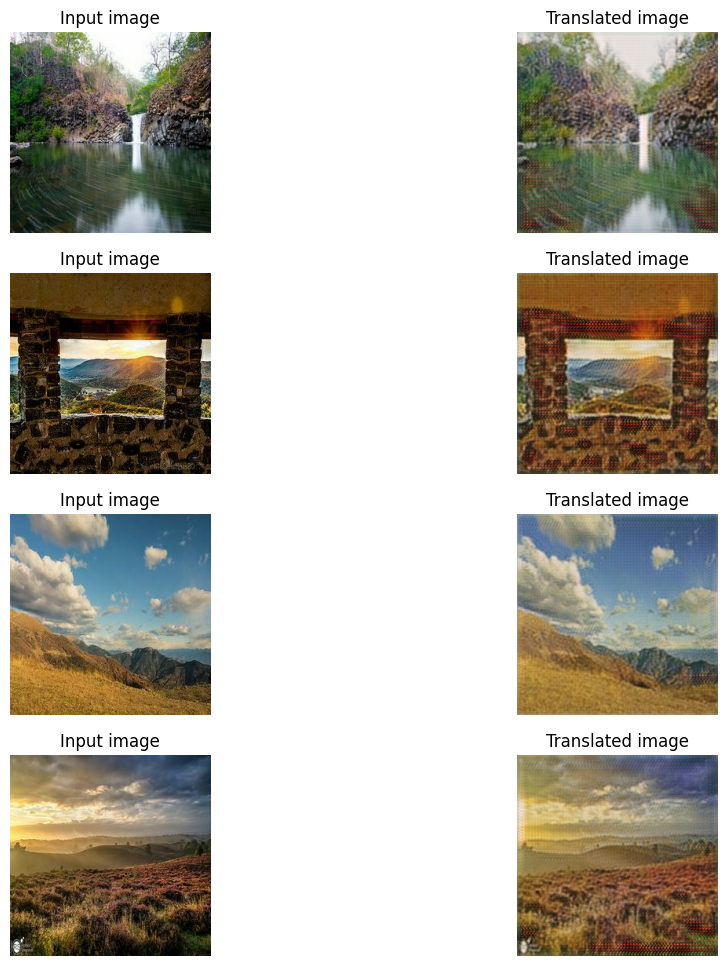

300/300 [==============================] - 43s 143ms/step - G_loss: 2.9305 - F_loss: 3.1476 - D_X_loss: 0.2347 - D_Y_loss: 0.2378
Epoch 17/25
300/300 [==============================] - ETA: 0s - G_loss: 2.9349 - F_loss: 3.0696 - D_X_loss: 0.2349 - D_Y_loss: 0.2392

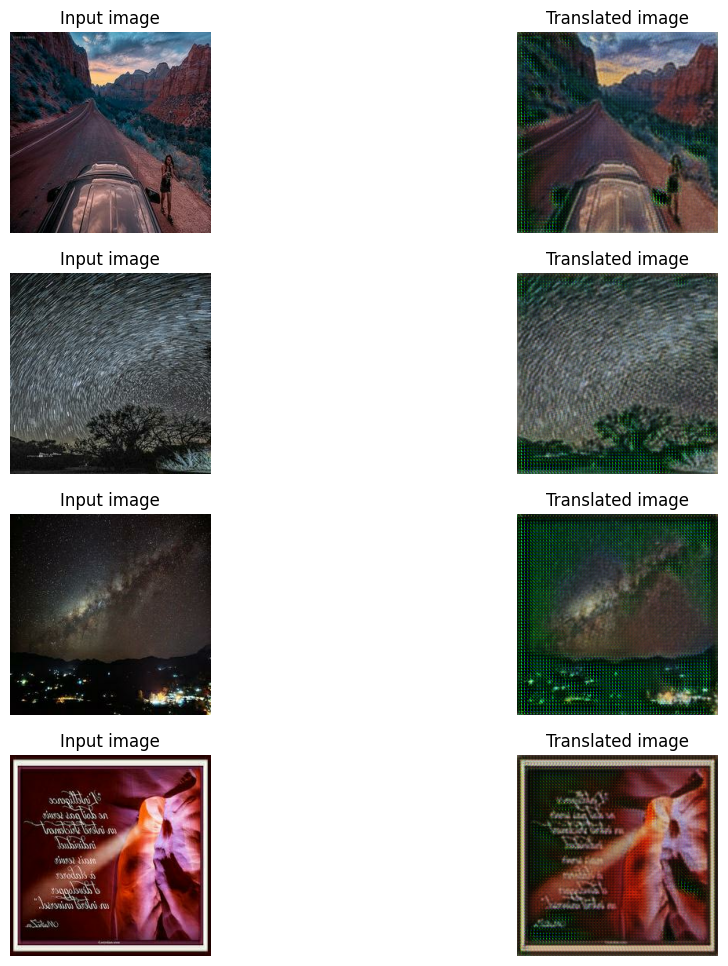

300/300 [==============================] - 43s 143ms/step - G_loss: 2.9313 - F_loss: 3.0722 - D_X_loss: 0.2346 - D_Y_loss: 0.2390
Epoch 18/25
300/300 [==============================] - ETA: 0s - G_loss: 2.9240 - F_loss: 3.0302 - D_X_loss: 0.2328 - D_Y_loss: 0.2357

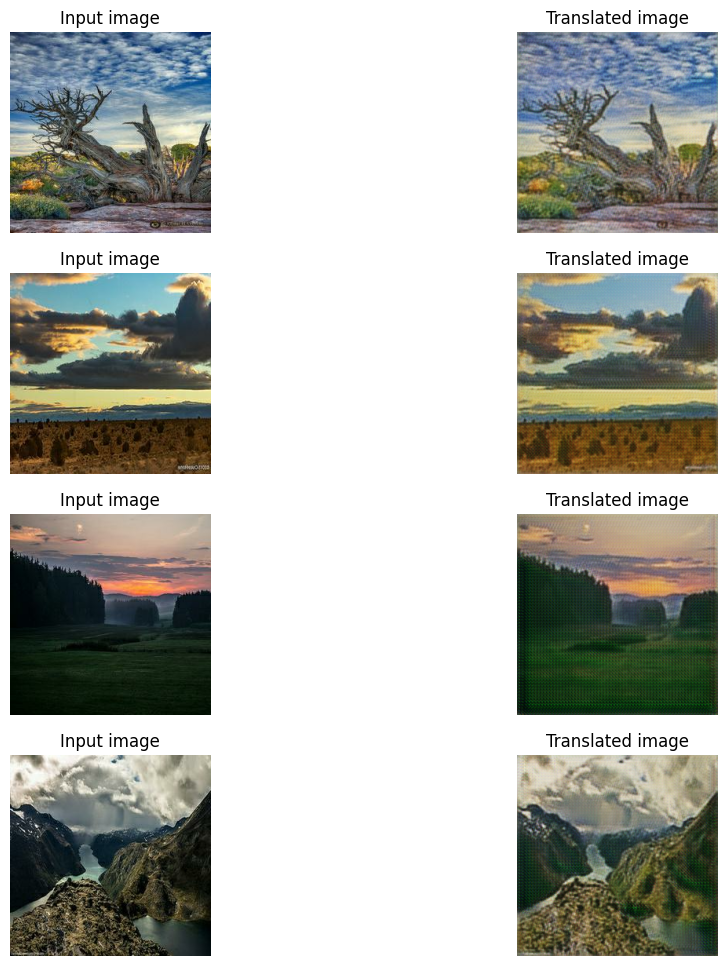

300/300 [==============================] - 43s 143ms/step - G_loss: 2.9236 - F_loss: 3.0304 - D_X_loss: 0.2328 - D_Y_loss: 0.2358
Epoch 19/25
300/300 [==============================] - ETA: 0s - G_loss: 2.8373 - F_loss: 3.0515 - D_X_loss: 0.2375 - D_Y_loss: 0.2370

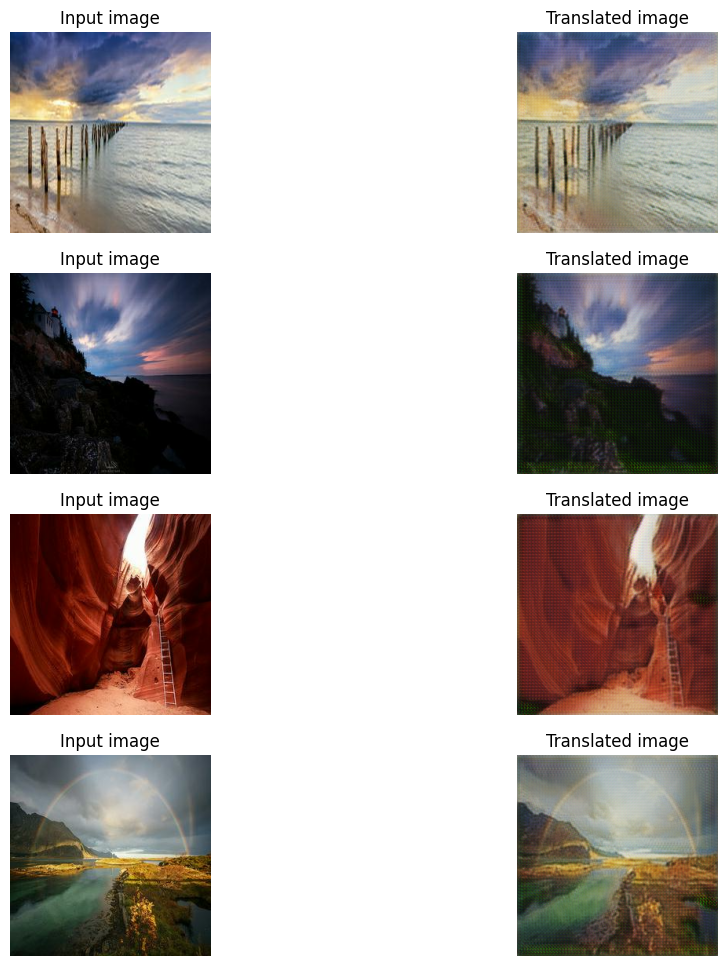

300/300 [==============================] - 43s 143ms/step - G_loss: 2.8379 - F_loss: 3.0570 - D_X_loss: 0.2376 - D_Y_loss: 0.2370
Epoch 20/25
300/300 [==============================] - ETA: 0s - G_loss: 2.8041 - F_loss: 2.9287 - D_X_loss: 0.2351 - D_Y_loss: 0.2407

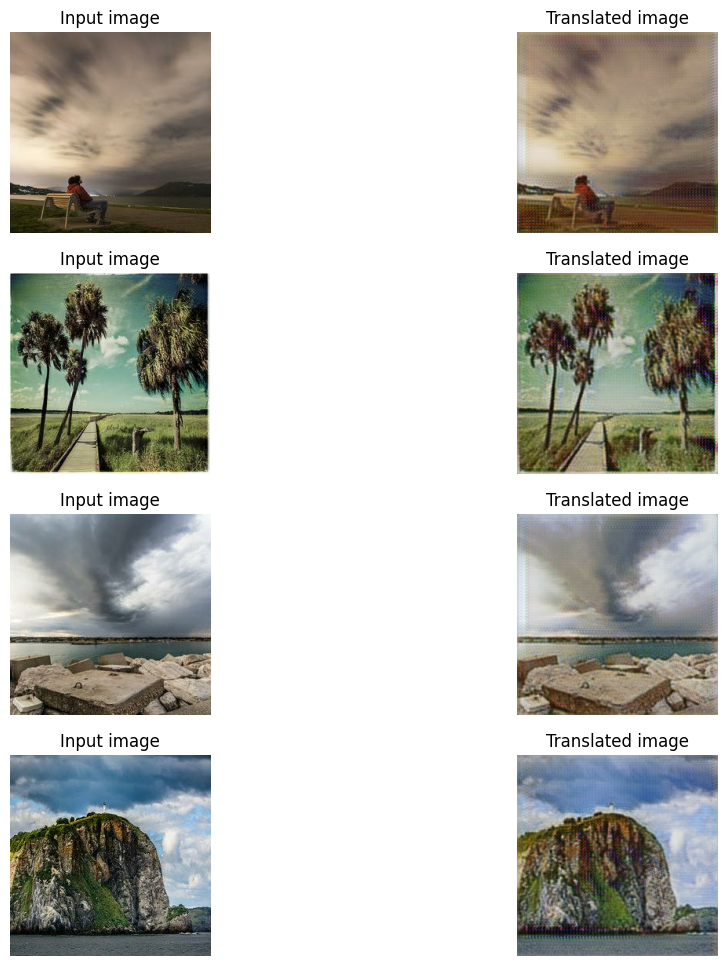

300/300 [==============================] - 43s 143ms/step - G_loss: 2.8058 - F_loss: 2.9291 - D_X_loss: 0.2351 - D_Y_loss: 0.2408
Epoch 21/25
300/300 [==============================] - ETA: 0s - G_loss: 2.8245 - F_loss: 3.0272 - D_X_loss: 0.2311 - D_Y_loss: 0.2361

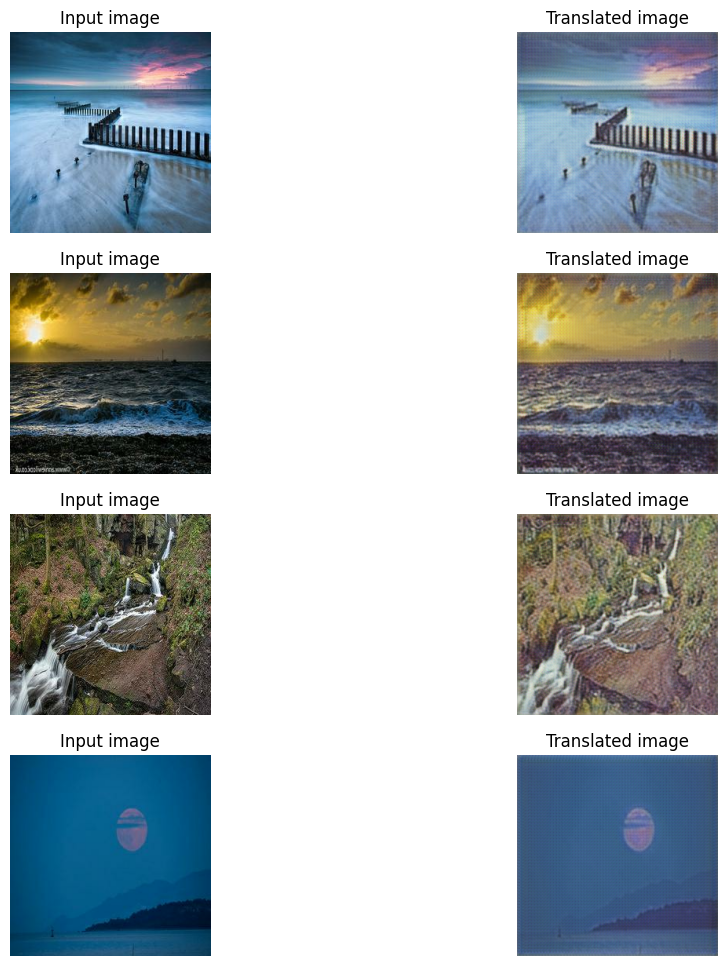

300/300 [==============================] - 43s 144ms/step - G_loss: 2.8243 - F_loss: 3.0285 - D_X_loss: 0.2314 - D_Y_loss: 0.2362
Epoch 22/25
300/300 [==============================] - ETA: 0s - G_loss: 2.7217 - F_loss: 2.9291 - D_X_loss: 0.2341 - D_Y_loss: 0.2353

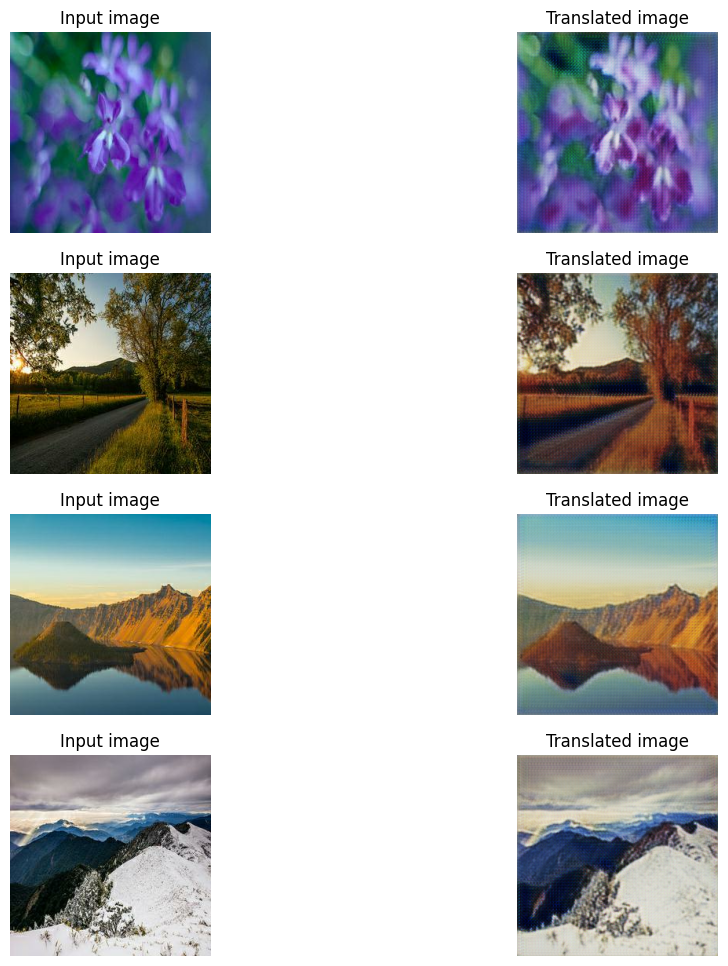

300/300 [==============================] - 43s 143ms/step - G_loss: 2.7250 - F_loss: 2.9259 - D_X_loss: 0.2343 - D_Y_loss: 0.2353
Epoch 23/25
300/300 [==============================] - ETA: 0s - G_loss: 2.6859 - F_loss: 2.9307 - D_X_loss: 0.2280 - D_Y_loss: 0.2371

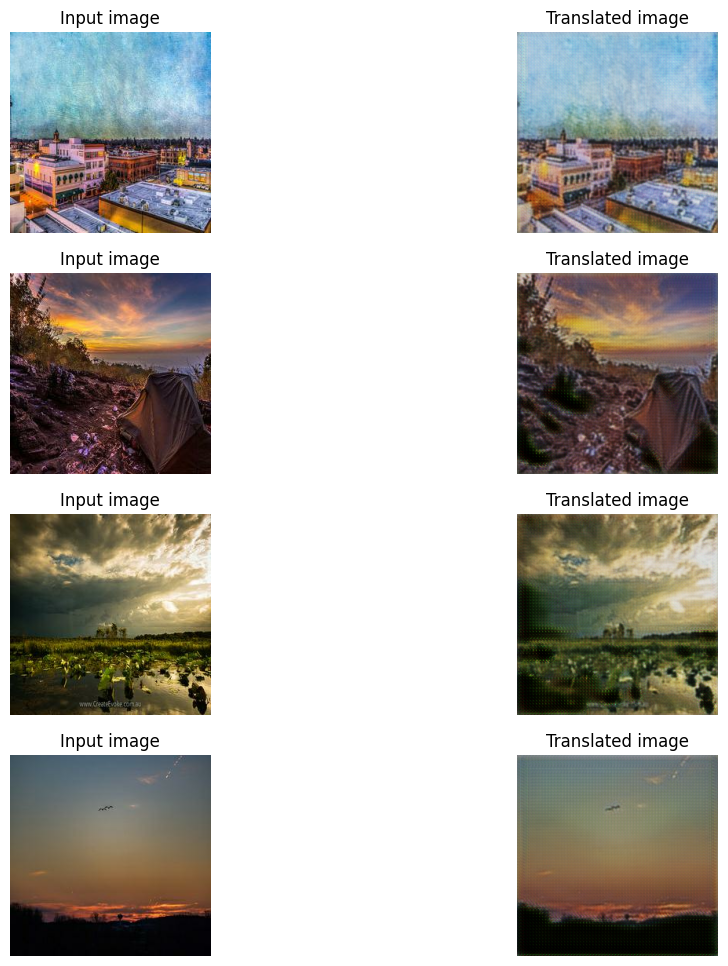

300/300 [==============================] - 43s 144ms/step - G_loss: 2.6847 - F_loss: 2.9283 - D_X_loss: 0.2280 - D_Y_loss: 0.2371
Epoch 24/25
300/300 [==============================] - ETA: 0s - G_loss: 2.6869 - F_loss: 2.9075 - D_X_loss: 0.2287 - D_Y_loss: 0.2375

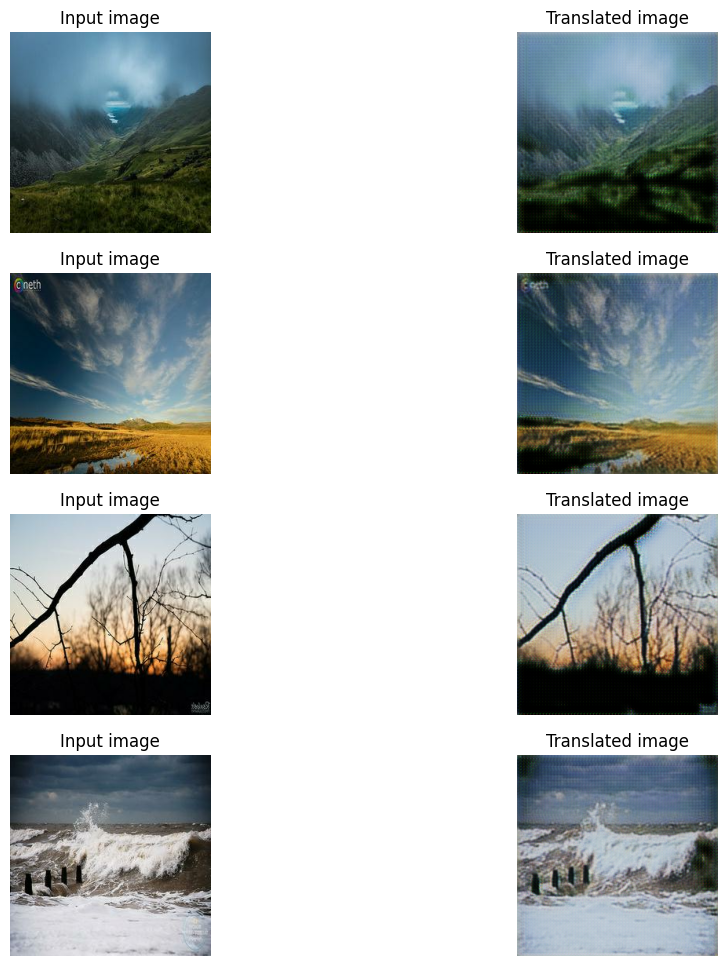

300/300 [==============================] - 43s 143ms/step - G_loss: 2.6853 - F_loss: 2.9078 - D_X_loss: 0.2286 - D_Y_loss: 0.2373
Epoch 25/25
300/300 [==============================] - ETA: 0s - G_loss: 2.6285 - F_loss: 2.8918 - D_X_loss: 0.2325 - D_Y_loss: 0.2424

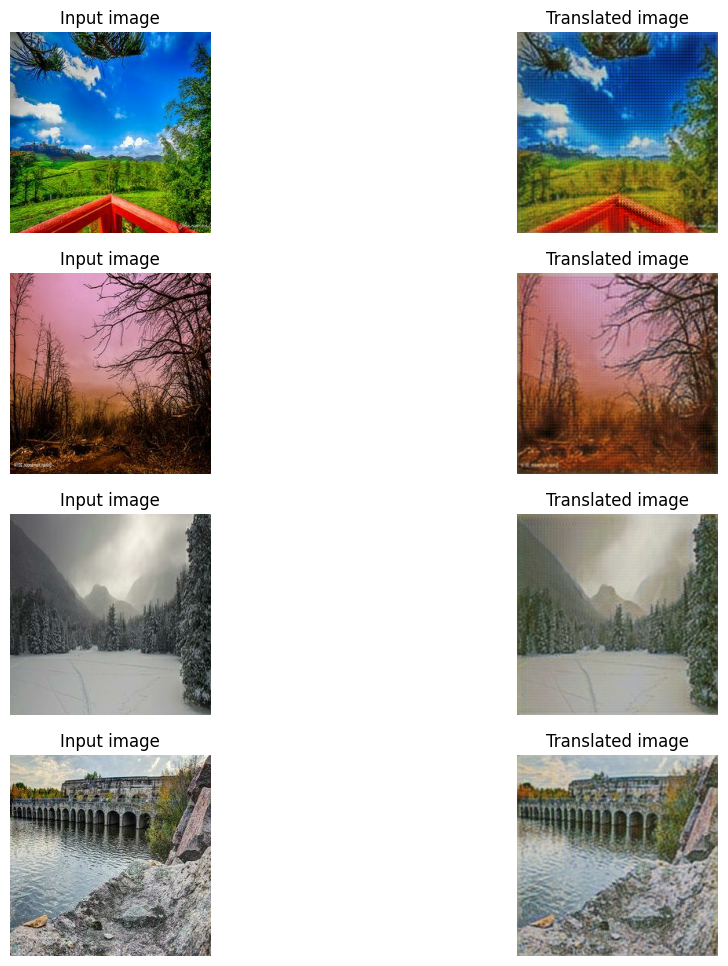

300/300 [==============================] - 43s 143ms/step - G_loss: 2.6267 - F_loss: 2.8945 - D_X_loss: 0.2325 - D_Y_loss: 0.2425


In [ ]:
import os
import pathlib
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
import tensorflow_addons as tfa
# Initializers and sizes
initializer = keras.initializers.RandomNormal(mean=0.0, stddev=0.05, seed=42)
orig_img_size = (256, 256)
input_img_size = (256, 256, 3)
buffer_size = 256
batch_size = 1

# --------------------------
# Parameters
# --------------------------
#num_epochs = 25  # <- Change number of epochs here
#learning_rate = 0.001  # <- Change learning rate here
#beta_1_value = 0.5

# Define the ResNet generator
def get_resnet_generator():
    inputs = layers.Input(shape=input_img_size)
    x = layers.Conv2D(64, (7, 7), padding='same', use_bias=False)(inputs)
    x = layers.BatchNormalization()(x)
    x = layers.Activation('relu')(x)

    # Downsampling
    for size in [128, 256]:
        x = layers.Conv2D(size, (3, 3), strides=2, padding='same', use_bias=False)(x)
        x = layers.BatchNormalization()(x)
        x = layers.Activation('relu')(x)

    # Residual blocks
    for _ in range(9):
        y = layers.Conv2D(256, (3, 3), padding='same', use_bias=False)(x)
        y = layers.BatchNormalization()(y)
        y = layers.Activation('relu')(y)
        y = layers.Conv2D(256, (3, 3), padding='same', use_bias=False)(y)
        y = layers.BatchNormalization()(y)
        x = layers.Add()([x, y])

    # Upsampling
    for size in [128, 64]:
        x = layers.Conv2DTranspose(size, (3, 3), strides=2, padding='same', use_bias=False)(x)
        x = layers.BatchNormalization()(x)
        x = layers.Activation('relu')(x)

    outputs = layers.Conv2D(3, (7, 7), padding='same', activation='tanh')(x)
    return keras.Model(inputs, outputs)

# Define the discriminator model
def get_discriminator():
    inputs = layers.Input(shape=input_img_size)
    x = layers.Conv2D(64, (4, 4), strides=2, padding='same', use_bias=False)(inputs)
    x = layers.LeakyReLU(alpha=0.2)(x)

    x = layers.Conv2D(128, (4, 4), strides=2, padding='same', use_bias=False)(x)
    x = layers.BatchNormalization()(x)
    x = layers.LeakyReLU(alpha=0.2)(x)

    outputs = layers.Conv2D(1, (4, 4), strides=1, padding='same')(x)
    return keras.Model(inputs, outputs)

# Instantiate generators and discriminators
gen_G = get_resnet_generator()
gen_F = get_resnet_generator()
disc_X = get_discriminator()
disc_Y = get_discriminator()

# Create and compile CycleGAN model
cycle_gan_model = CycleGan(generator_G=gen_G, generator_F=gen_F, discriminator_X=disc_X, discriminator_Y=disc_Y)
cycle_gan_model.compile(
    gen_G_optimizer=keras.optimizers.Adam(learning_rate=1e-4, beta_1=0.5),
    gen_F_optimizer=keras.optimizers.Adam(learning_rate=1e-4, beta_1=0.5),
    disc_X_optimizer=keras.optimizers.Adam(learning_rate=1e-4, beta_1=0.5),
    disc_Y_optimizer=keras.optimizers.Adam(learning_rate=1e-4, beta_1=0.5),
    # Add your loss functions here
    gen_loss_fn=generator_loss_fn,
    disc_loss_fn=discriminator_loss_fn,
)

# Initialize random weights
initializer = keras.initializers.RandomNormal(mean=0.0, stddev=0.05, seed=42)

# Directory paths for photo and Monet images
photo_directory = '/content/drive/My Drive/photo_jpg/'
monet_directory = '/content/drive/My Drive/monet_jpg/'

# Create datasets from these directories
ds_photo = tf.data.Dataset.list_files(str(pathlib.Path(photo_directory+'*.jpg')))
ds_monet = tf.data.Dataset.list_files(str(pathlib.Path(monet_directory+'*.jpg')))

# Function to process images
def process_path(file_path):
    image = tf.io.read_file(file_path)
    image = tf.image.decode_jpeg(image, channels=3)
    return image

# Apply the processing function to the datasets
ds_photo = ds_photo.map(process_path).prefetch(256)
ds_monet = ds_monet.map(process_path).prefetch(256)

# Initializers and sizes
orig_img_size = (256, 256)
input_img_size = (256, 256, 3)
buffer_size = 256
batch_size = 1

# Normalize images to [-1, 1]
def normalize_img(img):
    img = tf.cast(img, dtype=tf.float32)
    return ((img / 127.5) - 1.0)

# Image preprocessing function for training
def preprocess_train_image(img):
    img = tf.image.random_flip_left_right(img)
    img = tf.image.resize(img, [*orig_img_size])
    img = normalize_img(img)
    return img

# Apply the preprocessing function to datasets
ds_photo = ds_photo.map(preprocess_train_image, num_parallel_calls=tf.data.experimental.AUTOTUNE).cache().shuffle(buffer_size).batch(batch_size)
ds_monet = ds_monet.map(preprocess_train_image, num_parallel_calls=tf.data.experimental.AUTOTUNE).cache().shuffle(buffer_size).batch(batch_size)



# Create and compile CycleGAN model
cycle_gan_model = CycleGan(generator_G=gen_G, generator_F=gen_F, discriminator_X=disc_X, discriminator_Y=disc_Y)
cycle_gan_model.compile(
    # Changed learning rate to 1e-4
    gen_G_optimizer=keras.optimizers.Adam(learning_rate=1e-4, beta_1=0.5),
    gen_F_optimizer=keras.optimizers.Adam(learning_rate=1e-4, beta_1=0.5),
    disc_X_optimizer=keras.optimizers.Adam(learning_rate=1e-4, beta_1=0.5),
    disc_Y_optimizer=keras.optimizers.Adam(learning_rate=1e-4, beta_1=0.5),
    gen_loss_fn=generator_loss_fn,
    disc_loss_fn=discriminator_loss_fn,
)

# Callbacks for monitoring the GAN performance after each epoch
plotter = GANMonitor()

# Fit the model
# Changed the number of epochs to 5 for demonstration
cycle_gan_model.fit(tf.data.Dataset.zip((ds_photo, ds_monet)), epochs=25, callbacks=[plotter])

# Save the final model weights
# model_filepath = "<your path>"
# cycle_gan_model.save(model_filepath)
